Welcome. This notebook can be used to try out the service from Stability, and may also be used to straight copy the code for your production environment if you are developing an application using our API.

New to colab? Just hit the play button on each of the cells and follow instructions.

You will need an account on https://platform.stability.ai/ to use the features.

Have fun and do great things.

In [1]:
#@title Install requirements
from io import BytesIO
import IPython
import json
import os
from PIL import Image
import requests
import time
from google.colab import output

In [2]:
#@title Connect to the Stability API

import getpass
# @markdown To get your API key visit https://platform.stability.ai/account/keys
STABILITY_KEY = getpass.getpass('Enter your API Key')



Enter your API Key··········


In [3]:
#@title Define functions

def send_generation_request(
    host,
    params,
):
    headers = {
        "Accept": "image/*",
        "Authorization": f"Bearer {STABILITY_KEY}"
    }

    # Encode parameters
    files = {}
    image = params.pop("image", None)
    mask = params.pop("mask", None)
    if image is not None and image != '':
        files["image"] = open(image, 'rb')
    if mask is not None and mask != '':
        files["mask"] = open(mask, 'rb')
    if len(files)==0:
        files["none"] = ''

    # Send request
    print(f"Sending REST request to {host}...")
    response = requests.post(
        host,
        headers=headers,
        files=files,
        data=params
    )
    if not response.ok:
        raise Exception(f"HTTP {response.status_code}: {response.text}")

    return response

# Edit

Stable Image editing services include four offerings currently in production:

- Inpaint: where you specify a `mask` (or use the alpha channel of the `image` parameter). The `prompt` is what will be added to the image in the masked area. Regardless of input resolution, the output will be provided at 4mp.
- Search-and-Replace: where you specify what you want to replace in the input image via `search_prompt`. The `prompt` is what will be added to the image in place of the object from the search_prompt. Regardless of input resolution, the output will be provided at 4mp.
- Outpaint: Extend an image in any direction.
- Remove Background: Removes the background from an image.

See https://platform.stability.ai/docs/api-reference#tag/Edit

Pricing page: https://platform.stability.ai/pricing

Try these services out in the sections below. Check back in for regular updates.

Feedback welcome.

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/search-and-replace...
Saved image edited_chicken_585121657.webp


<IPython.core.display.Javascript object>

Original image:


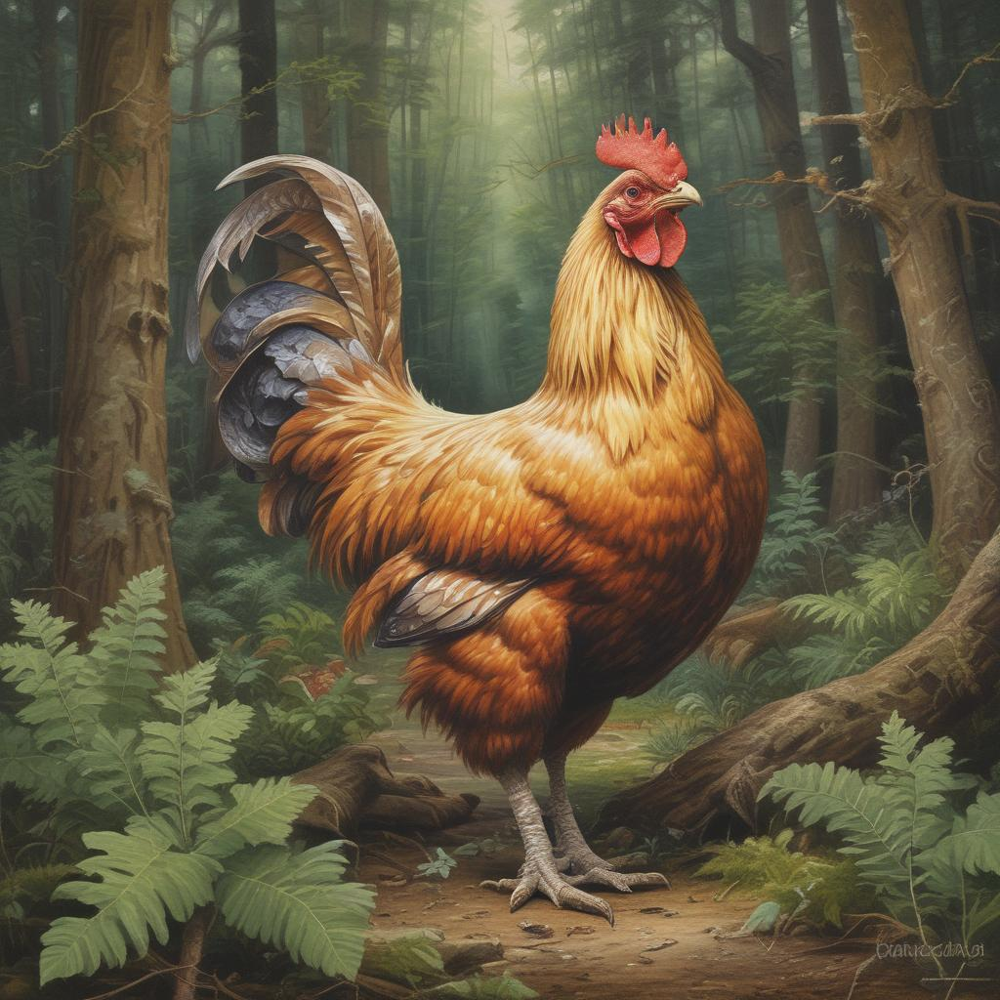

Result image:


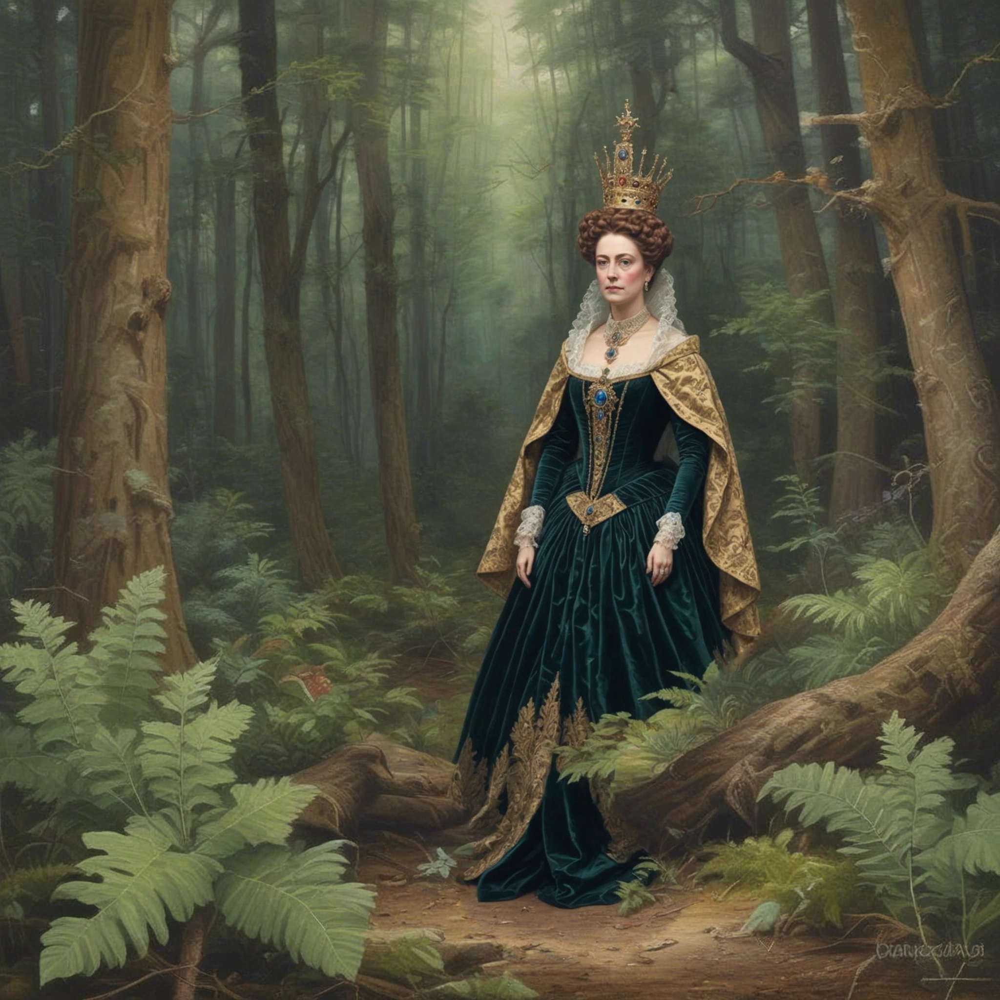

In [11]:
#@title Search-and-Replace

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/chicken.png" #@param {type:"string"}
prompt = "a victorian queen standing in the forest, looking at the viewer" #@param {type:"string"}
search_prompt = "chicken" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/search-and-replace"

params = {
    "image" : image,
    "seed" : seed,
    "mode": "search",
    "output_format": output_format,
    "prompt" : prompt,
    "negative_prompt" : negative_prompt,
    "search_prompt": search_prompt,
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/inpaint...
Saved image edited_tux_560568174.webp


<IPython.core.display.Javascript object>

Original image:


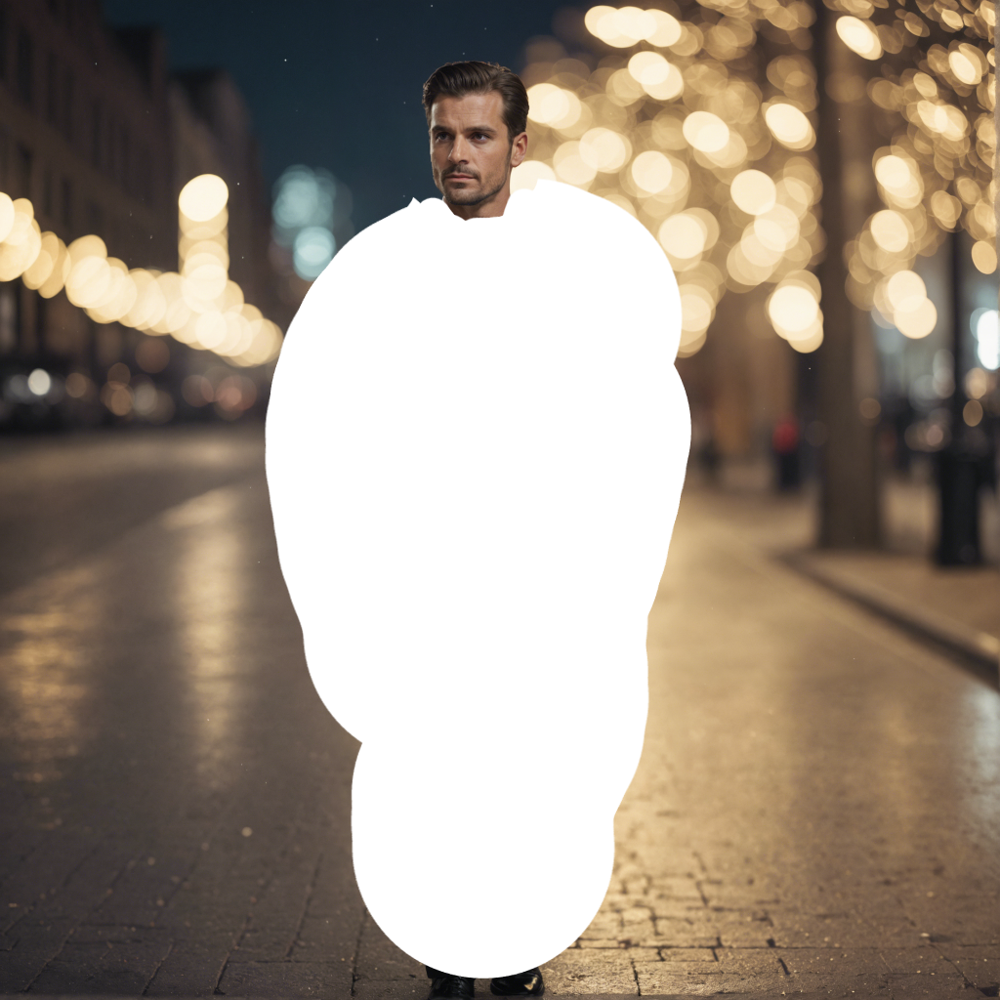

Result image:


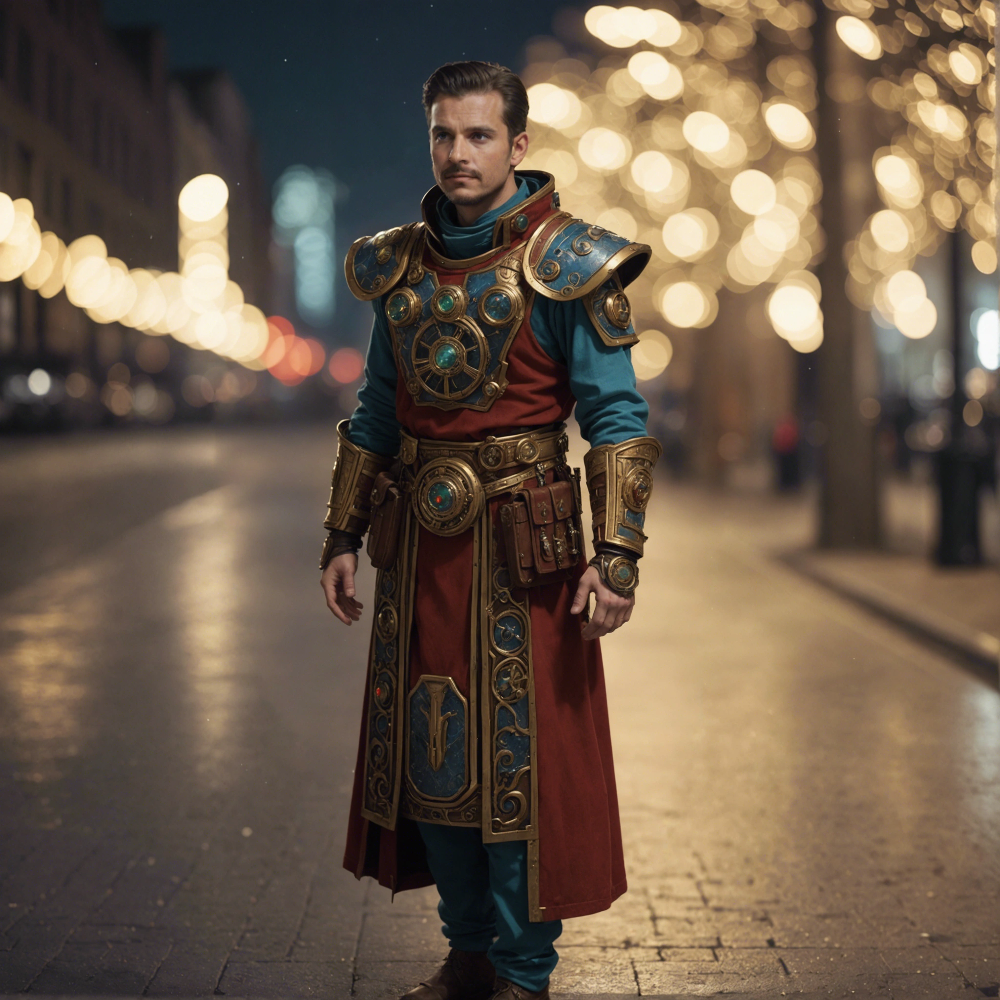

In [6]:
#@title Inpaint

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/tux.png" #@param {type:"string"}
mask = "" #@param {type:"string"}
prompt = "artificer of time and space" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/inpaint"

params = {
    "image" : image,
    "mask" : mask,
    "negative_prompt" : negative_prompt,
    "seed" : seed,
    "mode": "mask",
    "output_format": output_format,
    "prompt" : prompt
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/outpaint...
Saved image edited_chicken_2235532540.webp


<IPython.core.display.Javascript object>

Original image:


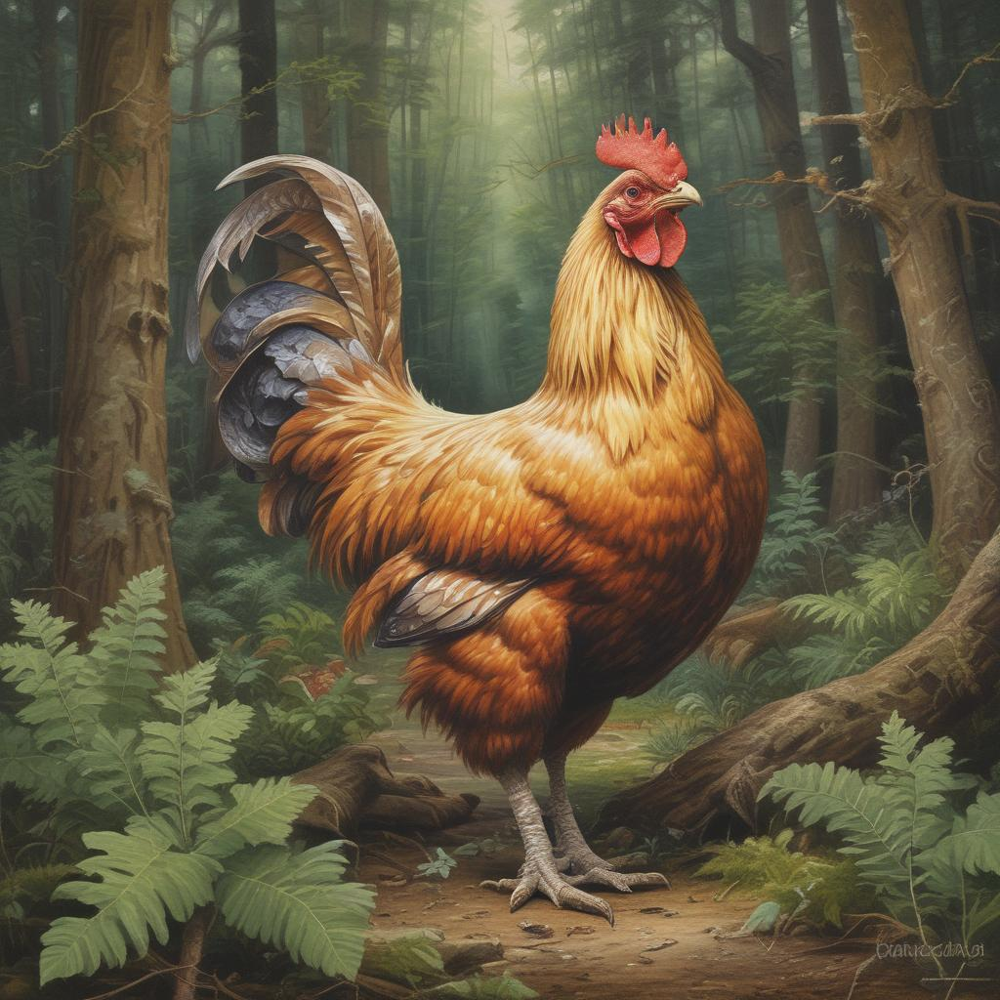

Result image:


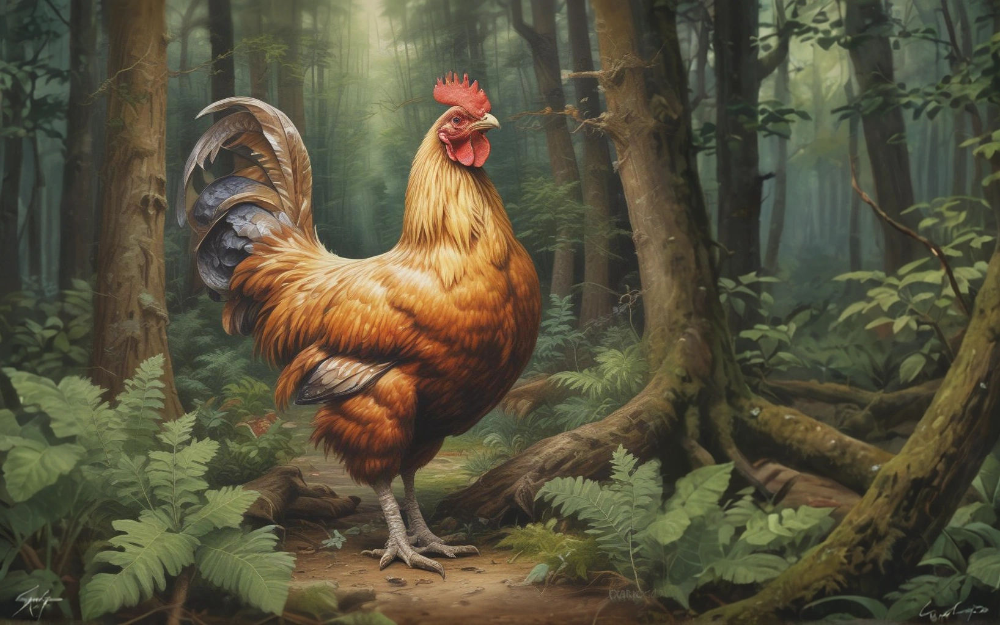

In [7]:
#@title Outpaint

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/chicken.png" #@param {type:"string"}
left = 100 #@param {type:"number"}
right = 512 #@param {type:"number"}
up = 0 #@param {type:"number"}
down = 0 #@param {type:"number"}
prompt = "" #@param {type:"string"}
seed = 0 #@param {type:"integer"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/outpaint"

params = {
    "image" : image,
    "left" : left,
    "right" : right,
    "up" : up,
    "down" : down,
    "prompt" : prompt,
    "seed" : seed,
    "output_format": output_format
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))

Sending REST request to https://api.stability.ai/v2beta/stable-image/edit/remove-background...
Saved image edited_img_2472543914.webp


<IPython.core.display.Javascript object>

Original image:


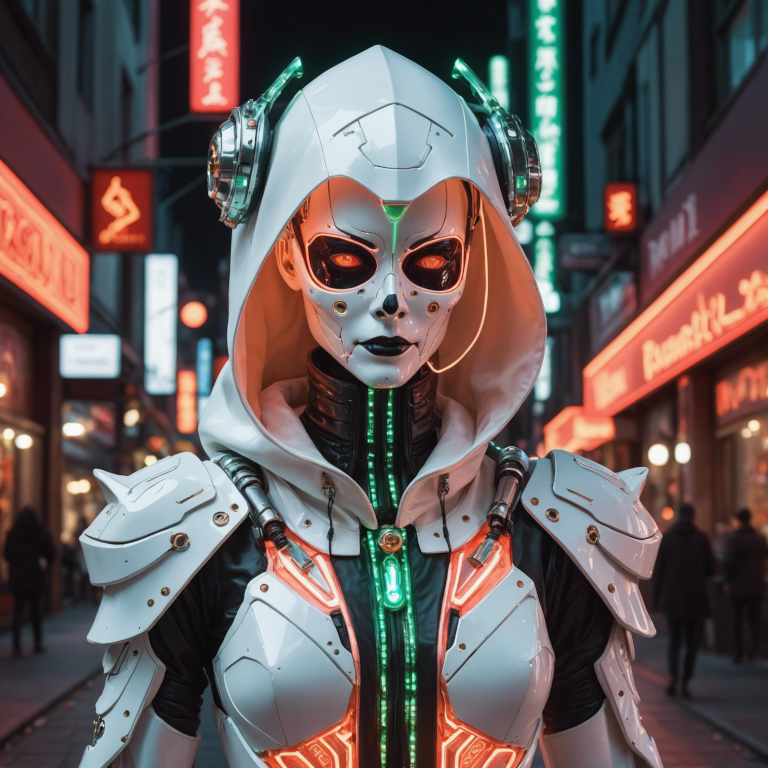

Result image:


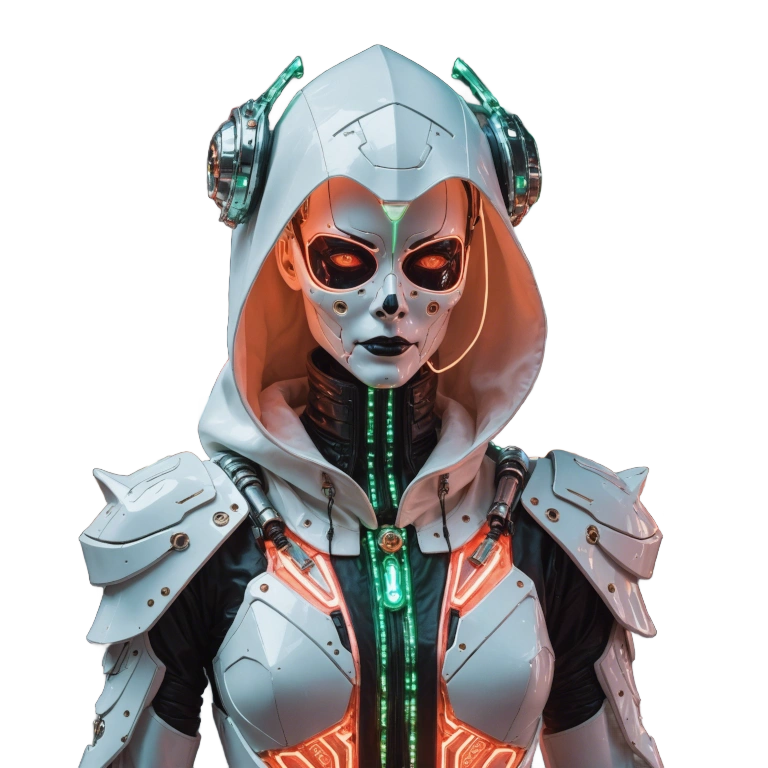

In [10]:
#@title Remove Background

#@markdown - Drag and drop image to file folder on left
#@markdown - Right click it and choose Copy path
#@markdown - Paste that path into image field below
#@markdown <br><br>

image = "/content/img.png" #@param {type:"string"}
output_format = "webp" #@param ["webp", "jpeg", "png"]

host = f"https://api.stability.ai/v2beta/stable-image/edit/remove-background"

params = {
    "image" : image,
    "output_format": output_format
}

response = send_generation_request(
    host,
    params
)

# Decode response
output_image = response.content
finish_reason = response.headers.get("finish-reason")
seed = response.headers.get("seed")

# Check for NSFW classification
if finish_reason == 'CONTENT_FILTERED':
    raise Warning("Generation failed NSFW classifier")

# Save and display result
filename, _ = os.path.splitext(os.path.basename(image))
edited = f"edited_{filename}_{seed}.{output_format}"
with open(edited, "wb") as f:
    f.write(output_image)
print(f"Saved image {edited}")

output.no_vertical_scroll()
print("Original image:")
IPython.display.display(Image.open(image))
print("Result image:")
IPython.display.display(Image.open(edited))